### Combine dungeness smolt trap data with temperature data (from hatchery) for years 2016-2020

In [87]:
#imports

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from urllib.request import urlopen
from bs4 import BeautifulSoup
import io
import datetime
import matplotlib.dates as mdates

In [90]:
def flow_data(year):
    url_flow = "https://apps.ecology.wa.gov/ContinuousFlowAndWQ/StationData/Prod/18A050/18A050_" + str(year)+ "_DSG_FM.TXT"
    html_flow = urlopen(url_flow).read()
    soup_flow = BeautifulSoup(html_flow, features="html.parser")

    # kill all script and style elements
    for script in soup_flow(["script", "style"]):
        script.extract()    # rip it out


    text_flow = soup_flow.get_text()
    
    if str(year) == "2017":
        text_flow = text_flow[519:-135]
    elif str(year) == "2018":
        text_flow = text_flow[519:-153]
    elif str(year) == "2019":
        text_flow = text_flow[519:-119]
    elif str(year) == "2020":
        text_flow = text_flow[519:-119]
    elif str(year) == "2016":
        text_flow = text_flow[519:-210]
    elif str(year) == "2015":
        text_flow = text_flow[519:-203]
        
    df_flow = pd.read_csv(io.StringIO(text_flow), sep='\s+', header = None, names = ["date", "time", "flow", "quality"])
    df_flow['midpoint'] =  pd.to_datetime(df_flow['date'] + ' ' + df_flow['time'])
    
    return(df_flow)

In [91]:
def read_csv(year):
    csv_name = "/home/maria/Documents/data/pied_piper/"+str(year)+"_dungeness_all_R.csv"
    df = pd.read_csv(csv_name, header=0)
    df['midpoint'] = pd.to_datetime(df['midpoint'])
    
    df_flow = flow_data(year)
    df_year_flow = pd.merge_asof(
        df.dropna(subset = ['midpoint']),df_flow, on="midpoint",tolerance=pd.Timedelta(minutes = 15))
    df_year_flow.to_csv("/home/maria/Documents/data/pied_piper/" + str(year) + "_dungeness_all.csv")
    return(df_year_flow)

    

In [110]:
read_csv(2020)

,Unnamed: 0,Down,In,Up,Date,Up_date,Down_time,Up_time,midpoint,steelheadsmolt_wild_perhour,...,coho0_wild_perhour,coho0_hatchery_perhour,chinook1_wild_perhour,chinook1_hatchery_perhour,chinook0_wild_perhour,chinook0_hatchery_perhour,date,time,flow,quality
0,1,2020-01-30 12:30:00,3.0,2020-01-30 15:30:00,2020-01-30,2020-01-30,1899-12-30 12:30:00,1899-12-30 15:30:00,2020-01-30 14:00:00,0.0,...,0.0,0,0.000,0,1.000000,0.0,01/30/2020,14:00,603.0,2
1,2,2020-01-30 15:30:00,17.5,2020-01-31 09:00:00,2020-01-30,2020-01-31,1899-12-30 15:30:00,1899-12-30 09:00:00,2020-01-31 00:15:00,0.0,...,0.0,0,0.000,0,8.571429,0.0,01/31/2020,00:15,567.0,2
2,3,2020-01-31 09:00:00,7.0,2020-01-31 16:00:00,2020-01-31,2020-01-31,1899-12-30 09:00:00,1899-12-30 16:00:00,2020-01-31 12:30:00,0.0,...,0.0,0,0.000,0,2.142857,0.0,01/31/2020,12:30,599.0,2
3,4,2020-01-31 16:00:00,3.5,2020-01-31 19:30:00,2020-01-31,2020-01-31,1899-12-30 16:00:00,1899-12-30 19:30:00,2020-01-31 17:45:00,0.0,...,0.0,0,0.000,0,26.571429,0.0,01/31/2020,17:45,774.0,2
4,5,2020-02-03 17:30:00,16.0,2020-02-04 09:30:00,2020-02-03,2020-02-04,1899-12-30 17:30:00,1899-12-30 09:30:00,2020-02-04 01:30:00,0.0,...,0.0,0,0.125,0,29.062500,0.0,02/04/2020,01:30,863.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265,266,2020-08-04 16:00:00,17.0,2020-08-05 09:00:00,2020-08-04,2020-08-05,1899-12-30 16:00:00,1899-12-30 09:00:00,2020-08-05 00:30:00,0.0,...,0.0,0,0.000,0,0.294118,0.0,08/05/2020,00:30,133.0,2
266,267,2020-08-05 16:00:00,16.0,2020-08-06 08:00:00,2020-08-05,2020-08-06,1899-12-30 16:00:00,1899-12-30 08:00:00,2020-08-06 00:00:00,0.0,...,0.0,0,0.000,0,0.250000,0.0,08/06/2020,00:00,131.0,2
267,268,2020-08-06 16:00:00,16.0,2020-08-07 08:00:00,2020-08-06,2020-08-07,1899-12-30 16:00:00,1899-12-30 08:00:00,2020-08-07 00:00:00,0.0,...,0.0,0,0.000,0,0.500000,0.0,08/07/2020,00:00,142.0,2
268,269,2020-08-09 20:00:00,13.0,2020-08-10 09:00:00,2020-08-09,2020-08-10,1899-12-30 20:00:00,1899-12-30 09:00:00,2020-08-10 02:30:00,0.0,...,0.0,0,0.000,0,0.230769,0.0,08/10/2020,02:30,112.0,2


In [98]:
def combine_data(year):
    csv_name = "/home/maria/Documents/data/pied_piper/"+str(year)+"_dungeness_all.csv"
    df = pd.read_csv(csv_name, header=0)
    df_temp = pd.read_excel(
       io="/home/maria/Documents/data/pied_piper/TempallDUNG_edited.xls",
       sheet_name =str(year),
        header = [0])
    df_temp['midpoint'] = df_temp['date_time']
    df['midpoint'] = pd.to_datetime(df['midpoint'])
    df_year_temp = pd.merge_asof(
        df.dropna(subset = ['midpoint']),df_temp, on="midpoint",tolerance=pd.Timedelta(hours = 2))
    df_year_temp.to_csv("/home/maria/Documents/data/pied_piper/" + str(year) + "_dungeness_all.csv")
    with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
        display(df_year_temp)
    

In [99]:
def aggregate(year):
    csv_name = "/home/maria/Documents/data/pied_piper/"+str(year)+"_dungeness_all.csv"
    df_year_flow = pd.read_csv(csv_name, header=0)
    groupedby_dates_year = df_year_flow.groupby(by=["Date"]).agg({'In':'sum',
                                                                       'chinook0_hatchery_perhour':'sum',
                                                                       'chinook0_wild_perhour':'sum',
                                                                       'chinook1_hatchery_perhour':'sum',
                                                                       'chinook1_wild_perhour':'sum',
                                                                       'coho1_hatchery_perhour':'sum',
                                                                       'coho1_wild_perhour':'sum',
                                                                       'steelheadsmolt_hatchery_perhour':'sum',
                                                                       'steelheadsmolt_wild_perhour':'sum',
                                                                       'flow':'mean',
                                                                 'temp':'mean'})
    groupedby_dates_year.to_csv("/home/maria/Documents/data/pied_piper/"+str(year)+"_dungeness.csv")

In [111]:
combine_data(2020)

,Unnamed: 0,Unnamed: 0.1,Down,In,Up,Date,Up_date,Down_time,Up_time,midpoint,steelheadsmolt_wild_perhour,steelheadsmolt_hatchery_perhour,coho1_wild_perhour,coho1_hatchery_perhour,coho0_wild_perhour,coho0_hatchery_perhour,chinook1_wild_perhour,chinook1_hatchery_perhour,chinook0_wild_perhour,chinook0_hatchery_perhour,date,time,flow,quality,date_time,temp,temp_F
0,0,1,2020-01-30 12:30:00,3.000000,2020-01-30 15:30:00,2020-01-30,2020-01-30,1899-12-30 12:30:00,1899-12-30 15:30:00,2020-01-30 14:00:00,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0,1.000000,0.000000,01/30/2020,14:00,603.0,2,NaT,NaN,NaN
1,1,2,2020-01-30 15:30:00,17.500000,2020-01-31 09:00:00,2020-01-30,2020-01-31,1899-12-30 15:30:00,1899-12-30 09:00:00,2020-01-31 00:15:00,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0,8.571429,0.000000,01/31/2020,00:15,567.0,2,NaT,NaN,NaN
2,2,3,2020-01-31 09:00:00,7.000000,2020-01-31 16:00:00,2020-01-31,2020-01-31,1899-12-30 09:00:00,1899-12-30 16:00:00,2020-01-31 12:30:00,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0,2.142857,0.000000,01/31/2020,12:30,599.0,2,NaT,NaN,NaN
3,3,4,2020-01-31 16:00:00,3.500000,2020-01-31 19:30:00,2020-01-31,2020-01-31,1899-12-30 16:00:00,1899-12-30 19:30:00,2020-01-31 17:45:00,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0,26.571429,0.000000,01/31/2020,17:45,774.0,2,NaT,NaN,NaN
4,4,5,2020-02-03 17:30:00,16.000000,2020-02-04 09:30:00,2020-02-03,2020-02-04,1899-12-30 17:30:00,1899-12-30 09:30:00,2020-02-04 01:30:00,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.125000,0,29.062500,0.000000,02/04/2020,01:30,863.0,2,NaT,NaN,NaN
5,5,6,2020-02-04 09:30:00,7.500000,2020-02-04 17:00:00,2020-02-04,2020-02-04,1899-12-30 09:30:00,1899-12-30 17:00:00,2020-02-04 13:15:00,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0,0.800000,0.000000,02/04/2020,13:15,781.0,2,NaT,NaN,NaN
6,6,7,2020-02-05 08:17:00,8.616667,2020-02-05 16:54:00,2020-02-05,2020-02-05,1899-12-30 08:17:00,1899-12-30 16:54:00,2020-02-05 12:35:30,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.116054,0,2.669246,0.000000,02/05/2020,12:30,804.0,2,NaT,NaN,NaN
7,7,8,2020-02-05 16:54:00,17.766667,2020-02-06 10:40:00,2020-02-05,2020-02-06,1899-12-30 16:54:00,1899-12-30 10:40:00,2020-02-06 01:47:00,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0,7.741088,0.000000,02/06/2020,01:45,903.0,2,NaT,NaN,NaN
8,8,9,2020-02-06 10:40:00,8.333333,2020-02-06 19:00:00,2020-02-06,2020-02-06,1899-12-30 10:40:00,1899-12-30 19:00:00,2020-02-06 14:50:00,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0,6.360000,0.000000,02/06/2020,14:45,1170.0,2,NaT,NaN,NaN
9,9,10,2020-02-07 13:00:00,3.500000,2020-02-07 16:30:00,2020-02-07,2020-02-07,1899-12-30 13:00:00,1899-12-30 16:30:00,2020-02-07 14:45:00,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0,2.857143,0.000000,02/07/2020,14:45,1310.0,2,NaT,NaN,NaN


In [112]:
aggregate(2020)

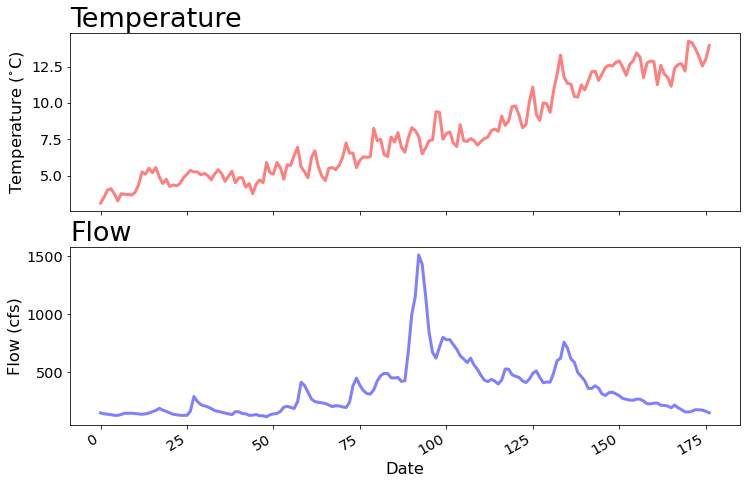

In [57]:
year = 2008

csv_name = "/home/maria/Documents/data/pied_piper/"+str(year)+"_dungeness.csv"
groupedby_dates_year = pd.read_csv(csv_name, header=0)
#plot temperature and flow
fs = 18
lw = 3
transparency = 0.5
plt.close('all') # always start by cleaning up
fig = plt.figure(figsize=(12,8))

ax1 = fig.add_subplot(211)
ax1.plot(
    groupedby_dates_year.index, groupedby_dates_year['temp'], color = 'red', 
    label = 'temperature', alpha = 0.5, linewidth = lw)
plt.gcf().autofmt_xdate()
plt.xlabel('Date', size = 0.9*fs)
plt.ylabel('Temperature '+ r'($^{\circ}$C)', size = 0.9*fs)
ax1.tick_params(labelsize=.8*fs)
ax1.set_title('Temperature', loc='left', fontsize = fs*1.5)
#plt.legend(fontsize=fs, loc='upper right', title = '')


#flow
ax2 = fig.add_subplot(212)
ax2.plot(
    groupedby_dates_year.index, groupedby_dates_year['flow'], color = 'blue', 
    label = 'flow', alpha = 0.5, linewidth = lw)
plt.gcf().autofmt_xdate()
plt.xlabel('Date', size = 0.9*fs)
plt.ylabel('Flow (cfs)', size = 0.9*fs)
ax2.tick_params(labelsize=.8*fs)
ax2.set_title('Flow', loc='left', fontsize = fs*1.5)
#plt.legend(fontsize=fs, loc='upper right', title = '')

plt.show()

In [58]:
years = range(2005,2021)
csv_names = []
for year in years:
    csv_names.append("/home/maria/Documents/data/pied_piper/"+str(year)+"_dungeness.csv")
    
df = pd.concat([pd.read_csv(csv_name, header=0) for csv_name in csv_names])

#day of year
df['Date_datetime'] = pd.to_datetime(df['Date'])
df['doy'] = df['Date_datetime'].dt.dayofyear
df['year'] = df['Date_datetime'].dt.year

#groupby day of year
groupedby_doy = df.groupby(by=["doy"]).agg({'chinook0_perhour':'mean',
                                            'chinook0_hatchery_perhour':'mean',
                                            'chinook0_wild_perhour':'mean',
                                            'chinook1_perhour':'mean',
                                            'chinook1_hatchery_perhour':'mean',
                                            'chinook1_wild_perhour':'mean',
                                            'coho1_perhour':'mean',
                                            'coho1_hatchery_perhour':'mean',
                                            'coho1_wild_perhour':'mean',
                                            'steelheadsmolt_perhour':'mean',
                                            'steelheadsmolt_hatchery_perhour':'mean',
                                            'steelheadsmolt_wild_perhour':'mean',
                                            'steelheadsmolt_parr_perhour':'mean'})
#moving average

#chinook0
groupedby_doy['ma_chinook0_wild_perhour'] = groupedby_doy['chinook0_wild_perhour'].rolling(7, min_periods=1, center=True).mean()
groupedby_doy['ma_chinook0_hatchery_perhour'] = groupedby_doy['chinook0_hatchery_perhour'].rolling(7, min_periods=1, center=True).mean()
groupedby_doy['ma_chinook0_perhour'] = groupedby_doy['chinook0_perhour'].rolling(7, min_periods=1, center=True).mean()

#chinook1
groupedby_doy['ma_chinook1_wild_perhour'] = groupedby_doy['chinook1_wild_perhour'].rolling(7, min_periods=1, center=True).mean()
groupedby_doy['ma_chinook1_hatchery_perhour'] = groupedby_doy['chinook1_hatchery_perhour'].rolling(7, min_periods=1, center=True).mean()
groupedby_doy['ma_chinook1_perhour'] = groupedby_doy['chinook1_perhour'].rolling(7, min_periods=1, center=True).mean()

#coho1
groupedby_doy['ma_coho1_wild_perhour'] = groupedby_doy['coho1_wild_perhour'].rolling(7, min_periods=1, center=True).mean()
groupedby_doy['ma_coho1_hatchery_perhour'] = groupedby_doy['coho1_hatchery_perhour'].rolling(7, min_periods=1, center=True).mean()
groupedby_doy['ma_coho1_perhour'] = groupedby_doy['coho1_perhour'].rolling(7, min_periods=1, center=True).mean()

#steelhead
groupedby_doy['ma_steelheadsmolt_wild_perhour'] = groupedby_doy['steelheadsmolt_wild_perhour'].rolling(7, min_periods=1, center=True).mean()
groupedby_doy['ma_steelheadsmolt_hatchery_perhour'] = groupedby_doy['steelheadsmolt_hatchery_perhour'].rolling(7, min_periods=1, center=True).mean()
groupedby_doy['ma_steelheadsmolt_parr_perhour'] = groupedby_doy['steelheadsmolt_perhour'].rolling(7, min_periods=1, center=True).mean()
groupedby_doy['ma_steelheadsmolt_perhour'] = groupedby_doy['steelheadsmolt_parr_perhour'].rolling(7, min_periods=1, center=True).mean()

combined_ma = pd.merge(df, groupedby_doy, left_on="doy", right_on="doy", how="left", validate="m:1")

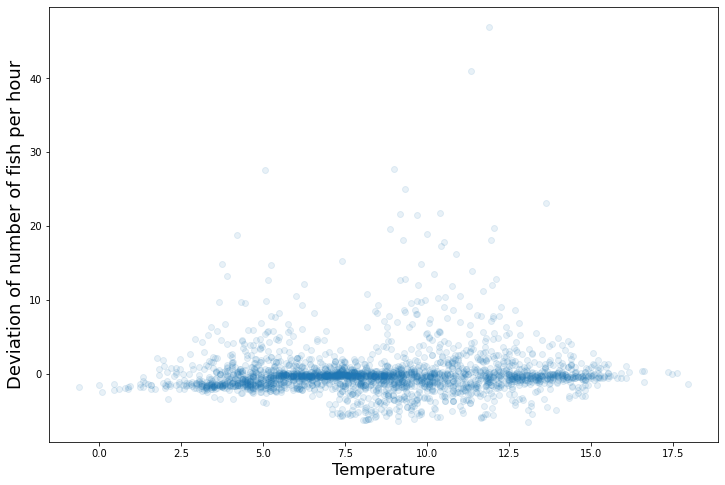

In [60]:
x = combined_ma['temp']
y = combined_ma['chinook0_wild_perhour_x'] - combined_ma['ma_chinook0_wild_perhour']
fig = plt.figure(figsize=(12,8))
fs = 18
ax = fig.add_subplot(111)
plt.scatter(x,y, alpha = 0.1)
ax.set_xlabel('Temperature', fontsize = fs*0.9)
ax.set_ylabel('Deviation of number of fish per hour', fontsize = fs)
plt.savefig("/home/maria/Documents/output/pied_piper/temperature_deviation.jpeg", dpi = 300)

In [62]:
#write the combined dataframe to csv
combined_ma.to_csv("/home/maria/Documents/data/pied_piper/dungeness_2005-2020_combine_doy.csv")  


In [67]:
years = range(2005,2021)
csv_names = []
for year in years:
    csv_names.append("/home/maria/Documents/data/pied_piper/"+str(year)+"_dungeness_all.csv")
    
df_all = pd.concat([pd.read_csv(csv_name, header=0) for csv_name in csv_names])

#day of year
df_all['Date_datetime'] = pd.to_datetime(df_all['Date'])
df_all['midpoint'] = pd.to_datetime(df_all['midpoint'])
df_all['doy'] = df_all['Date_datetime'].dt.dayofyear
df_all['year'] = df_all['Date_datetime'].dt.year
df_all['hour'] = df_all['midpoint'].dt.hour

In [70]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    display(df_all)

,Unnamed: 0,Down,Up,In,Out,Chinook0_Wild,Chinook1_Total,Chum,Coho0_Total,Coho1_Total,Pink,Sockeye,Trout parr,Steelhead1_Total,Cutthroat smolts,Chinook1_Hat,Coho1_Wild,Coho1_Wild1,Coho1_Hat,Coho1_Hat1,Cutthroat parr unmark wild,Cutthroat adult unmark wild,Steelhead parr unmark wild,Steelhead1_Wild,Steelhead1_Hat,Steelhead adult unmark wild,Dolly Varden / Bull trout parr unmark wild,Dolly Varden / Bull trout smolt unmark wild,Date,midpoint,date_x,time_x,temp,quality_x,date_y,time_y,flow,quality_y,Chinook0_Total,Chinook0_HatCWT,Chinook0_Unmk Wld,Chinook1_HatCWT,Chinook1_Unmk,Coho1_Wild UC,Coho1_Wldunmk,Coho1_Hat-AD,Chum_Total,Pink_Total,Steelhead1_WldUC,Steelhead1_Wldunmk,Steelhead1_Hat-AD,Steely_Adult,Cutthroat_Smolts,Dolly varden_Smolt,Dolly varden_Adult,Trout Parr_Total,Trout Parr_Steely,Trout Parr_Cutts,Down_time,Up_date,Up_time,Chinook0_Hat,Chinook1_Wild,Coho1_Wild2,Steelhead1_Wild1,Steelhead1_Wild2,Coho0,Trout Parr_Wild_Total,Trout Parr_Wild_Steelhead,Trout Parr_Wild_Cutthroat,Cutthroat_Wild_Smolt,Cutthroat_Wild_Adult,Dolly\Bull_Wild_Smolt,Chinook1_Hat1,Chum_Wild,Coho Fry_Wild,Pink_Hatchery,Pink_Wild_Unmarked,Cutthroat_Wild,Cutthroat_Wild.1,Trout Parr_Wild_65,Trout Parr_Wild_60,Dolly\Bull_Wild,Chinook0_Hat1,Chum_Wild_Unmarked,Coho Fry_Wild_Unmarked,Coho1_Hat2,Coho1_Hat3,Pink_Unmark,Pink_Hatchery_ad-mark,Cutthroat_Wild_Parr,Pink_Wild_Unmark,Steelhead1_Hat1,Chinook0_Hat2,Chinook1_Hat2,Dolly\Bull_Wild_Adult,Dolly\Bull_Adult_Stlh,Dolly\Bull_Adult_Stlh_Comments,Dolly\Bull_Trap Out_Stoppers w\partial catch removed from catch for estimated catch for outage period.,chinook0_perhour,chinook0_hatchery_perhour,chinook0_wild_perhour,chinook1_perhour,chinook1_hatchery_perhour,chinook1_wild_perhour,coho1_perhour,coho1_hatchery_perhour,coho1_wild_perhour,steelheadsmolt_perhour,steelheadsmolt_hatchery_perhour,steelheadsmolt_wild_perhour,steelheadsmolt_parr_perhour,Unnamed: 0.1,coho0_wild_perhour,date,time,quality,coho0_hatchery_perhour,Date_datetime,doy,year
0,0,2005-03-08 16:30:00,2005-03-09 12:14:00,19.733333,0.0,86.0,0.0,268.0,0.0,0.0,106.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2005-03-08,2005-03-09 02:22:00,03/09/2005,02:15,7.0,140.0,03/09/2005,02:15,154.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2005-03-08,67,2005
1,1,2005-03-09 13:06:00,2005-03-09 18:20:00,5.233333,0.0,1.0,0.0,30.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2005-03-09,2005-03-09 15:43:00,03/09/2005,15:30,8.8,140.0,03/09/2005,15:30,177.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2005-03-09,68,2005
2,2,2005-03-09 18:20:00,2005-03-09 20:13:00,1.883333,0.0,7.0,0.0,165.0,0.0,0.0,33.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2005-03-09,2005-03-09 19:16:30,03/09/2005,19:15,7.9,140.0,03/09/2005,19:15,180.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2005-03-09,68,2005
3,3,2005-03-09 20:13:00,2005-03-10 08:41:00,12.466667,0.0,53.0,0.0,599.0,0.0,0.0,56.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2005-03-09,2005-03-10 02:27:00,03/10/2005,02:15,6.7,140.0,03/10/2005,02:15,181.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [77]:
df_all['midpoint'].dt.hour

0       2
1      15
2      19
3       2
4      13
       ..
312     0
313     0
314     0
315     2
316     0
Name: midpoint, Length: 5310, dtype: int64